In [61]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.ensemble import RandomForestClassifier
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score,precision_score, recall_score, f1_score
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.feature_selection import SelectKBest, f_classif
from imblearn.over_sampling import RandomOverSampler
from sklearn.preprocessing import RobustScaler

In [62]:
# Load train and validation datasets
train_df = pd.read_csv('train.csv')
validation_df = pd.read_csv('valid.csv')
test_df = pd.read_csv('test(1).csv')
sample_label22 = pd.read_csv('sample_label2.csv')
sample_label1 = "sample_label1.csv"
sample_label2 = "sample_label2.csv"
sample_label3 = "sample_label3.csv"
sample_label4 = "sample_label4.csv"

# Evaluation of the training data

In [9]:
train_df.head(10)

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_251,feature_252,feature_253,feature_254,feature_255,feature_256,label_1,label_2,label_3,label_4
0,-1.928826,-0.291540,1.105909,2.070652,0.657838,-0.670940,-0.968238,0.049916,1.111149,-1.834592,...,-0.691538,-1.152522,0.441157,-1.494434,-0.344974,-0.395641,45,NaN,1,6
1,-1.709277,-1.008998,0.956611,4.313823,-0.669455,1.928765,0.162550,0.152173,2.356505,-2.898549,...,-0.668235,-0.532695,0.151163,-1.876885,1.651534,-2.706490,45,NaN,1,6
2,-1.906183,-0.357562,-0.682627,4.651838,-0.884940,1.159512,1.354481,-1.432248,2.160144,-3.175735,...,-0.026728,0.440408,2.745906,-0.680754,-0.643588,-2.587203,45,NaN,1,6
3,0.697872,-2.218567,-0.572214,1.192062,0.329554,0.741364,0.962354,0.993512,2.896854,-1.600380,...,0.709032,0.812106,1.055266,-0.915258,-0.924856,-1.318964,45,NaN,1,6
4,-1.976895,-0.496308,0.368102,3.739787,-0.132058,1.234980,-0.501003,0.881554,1.630941,-3.853953,...,-0.599700,-1.024829,1.869753,-2.498570,3.268253,-1.356606,45,NaN,1,6
5,-2.561401,0.111220,0.559863,-0.503281,-0.729518,-1.599218,0.069522,0.321870,1.285719,-2.137529,...,-1.027395,1.417516,2.281284,-1.537097,1.225132,-1.438603,45,NaN,1,6
6,-1.394469,0.462892,0.363677,4.045471,-0.849210,1.455652,-0.205352,-0.546052,2.027194,-3.171630,...,-0.402857,0.062448,3.135536,-0.563650,0.344467,-2.015402,45,NaN,1,6
7,-0.623220,-2.178408,1.883489,-0.650364,0.787031,0.537933,-0.110389,1.290416,2.026178,-2.182263,...,-2.274080,2.293283,1.852912,-2.943409,0.350462,1.189924,45,NaN,1,6
8,-1.068345,-1.792198,0.662711,-0.688096,0.774377,-0.255280,0.052683,1.174669,2.968052,-2.335130,...,-1.304697,2.235583,1.388651,-2.735641,0.209001,0.501786,45,NaN,1,6
9,-1.820355,-0.594247,1.407979,3.997827,-1.210464,1.153973,0.543455,-0.016808,2.559437,-2.560328,...,-0.859458,0.812887,0.703064,-1.490860,-0.391967,-1.946579,45,NaN,1,6


In [10]:
train_df.describe()

,feature_1,feature_2,feature_3,feature_4,feature_5,feature_6,feature_7,feature_8,feature_9,feature_10,...,feature_251,feature_252,feature_253,feature_254,feature_255,feature_256,label_1,label_2,label_3,label_4
count,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,...,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28520.000000,28040.000000,28520.000000,28520.000000
mean,-0.225478,-0.616421,-0.212878,0.336330,0.105467,-0.339634,-0.201756,0.742262,0.942325,-1.957584,...,-0.028098,0.296340,1.724439,-1.476765,0.687445,-1.563062,30.498843,27.975107,0.799299,5.997125
std,0.990632,1.005573,1.075468,1.248919,0.831132,1.073267,0.943505,1.055721,0.940459,0.876939,...,0.989497,1.173378,0.968611,1.032811,1.028328,1.243758,17.328389,5.735913,0.400532,2.375567
min,-4.023911,-5.582544,-4.679888,-4.284380,-3.010300,-5.034355,-4.355222,-3.806574,-2.922614,-5.203347,...,-3.679602,-3.905801,-3.301683,-5.490267,-3.810144,-6.056032,1.000000,22.000000,0.000000,0.000000
25%,-0.869656,-1.287018,-0.913419,-0.478661,-0.437171,-1.075753,-0.823699,0.064072,0.298269,-2.556436,...,-0.692262,-0.550897,1.121631,-2.130906,-0.008394,-2.404028,15.000000,25.000000,1.000000,6.000000
50%,-0.190790,-0.609782,-0.218800,0.295881,0.117310,-0.329571,-0.193263,0.755193,0.940786,-1.949847,...,-0.018218,0.295523,1.783432,-1.449978,0.639575,-1.650610,30.000000,27.000000,1.000000,6.000000
75%,0.457509,0.063174,0.490262,1.119242,0.657941,0.393339,0.417146,1.461846,1.579200,-1.345999,...,0.644112,1.128566,2.383575,-0.799414,1.347263,-0.805710,46.000000,30.000000,1.000000,6.000000
max,4.322171,3.876604,4.267163,5.828656,3.884939,3.890622,3.799406,4.817545,4.615069,1.147192,...,3.915582,4.458014,5.261775,2.861117,5.531152,3.338544,60.000000,61.000000,1.000000,13.000000


<Axes: >

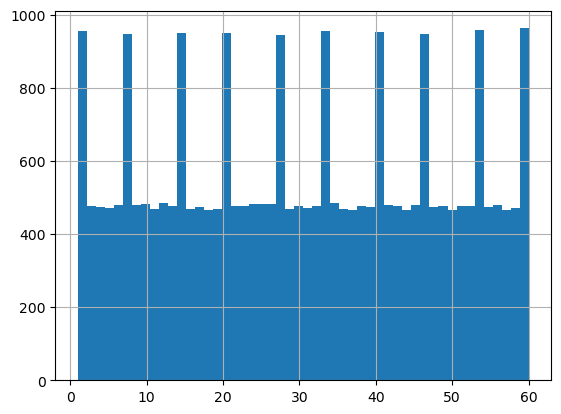

In [5]:
train_df['label_1'].hist(bins=50)

<Axes: >

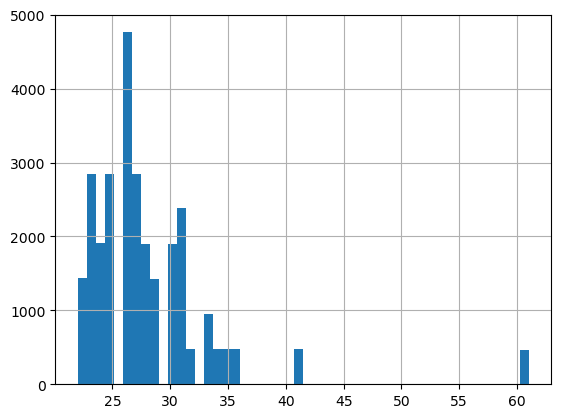

In [6]:
train_df['label_2'].hist(bins=50)

<Axes: >

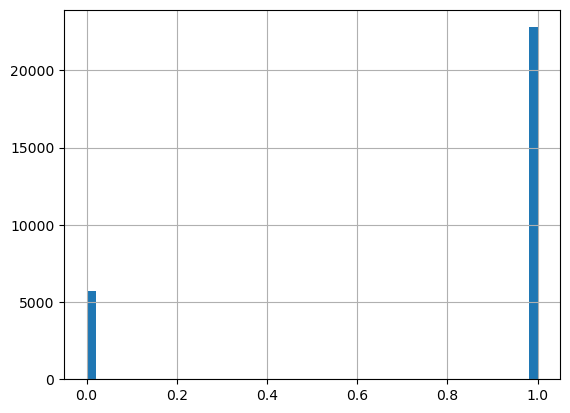

In [7]:
train_df['label_3'].hist(bins=50)

<Axes: >

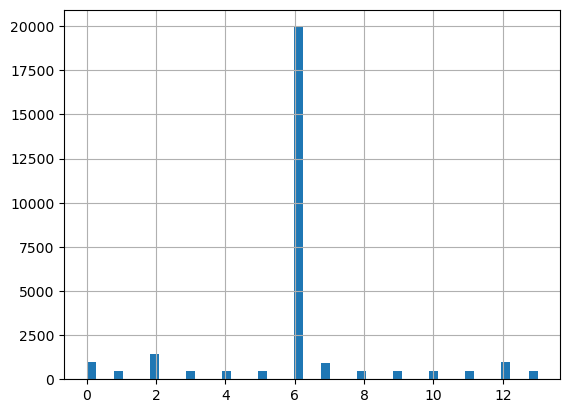

In [8]:
train_df['label_4'].hist(bins=50)

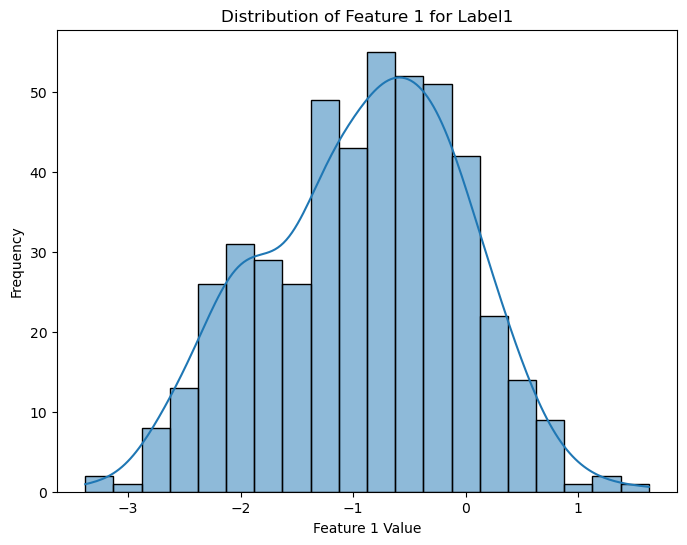

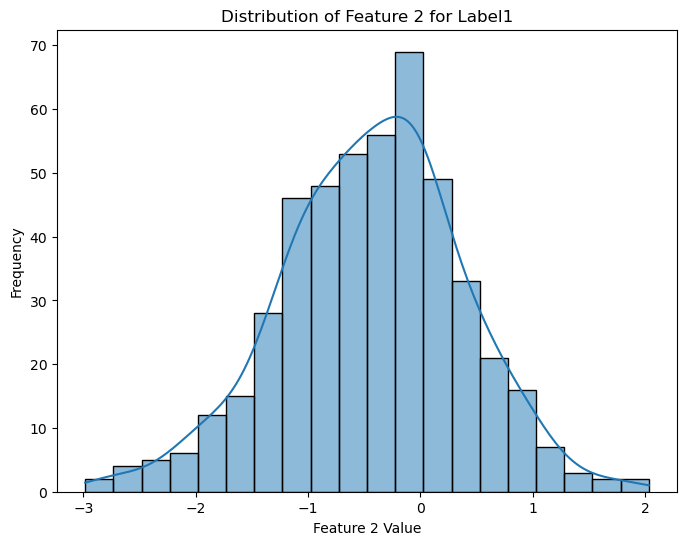

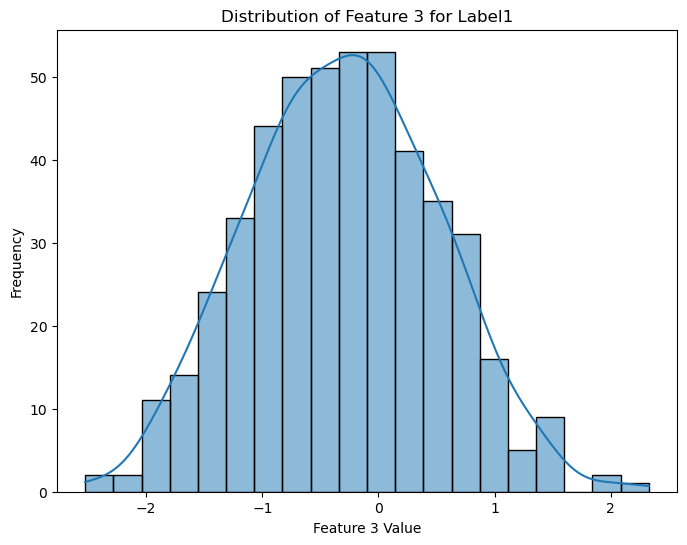

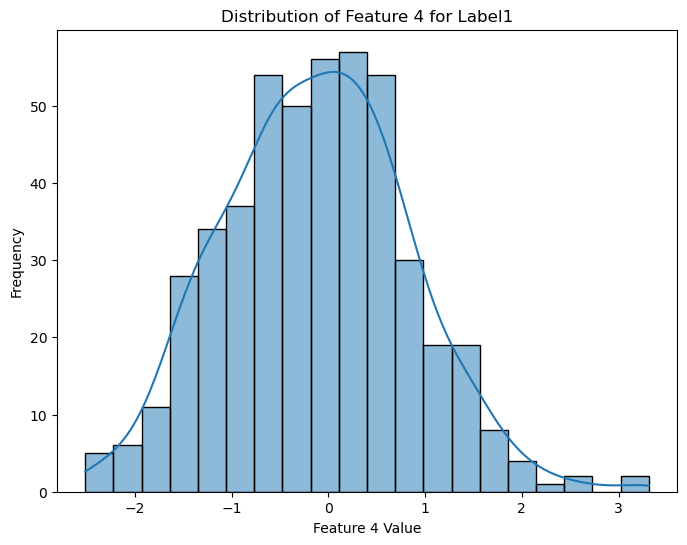

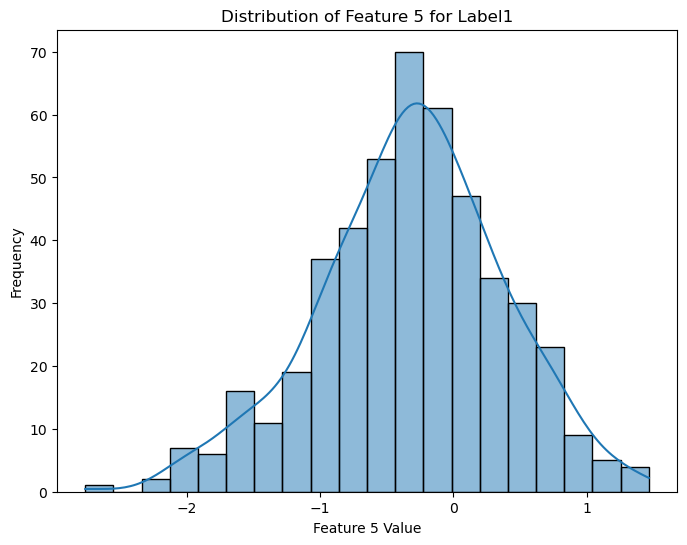

...

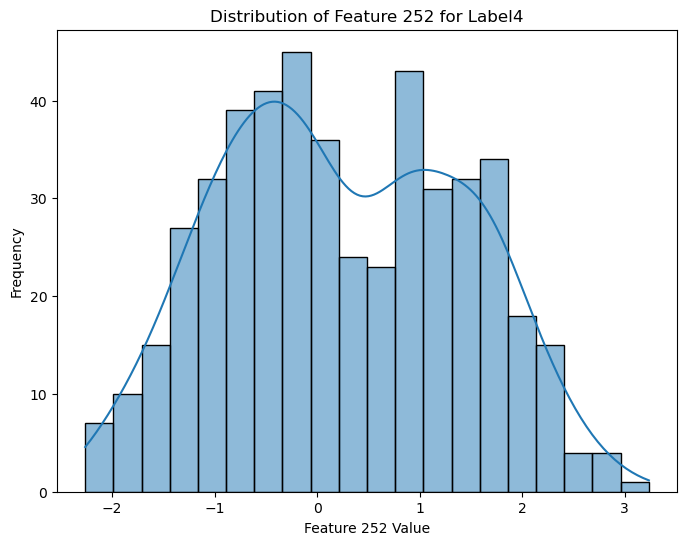

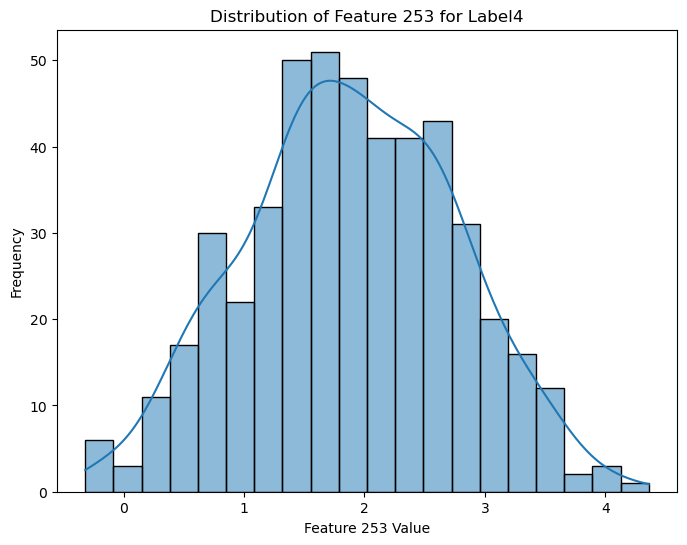

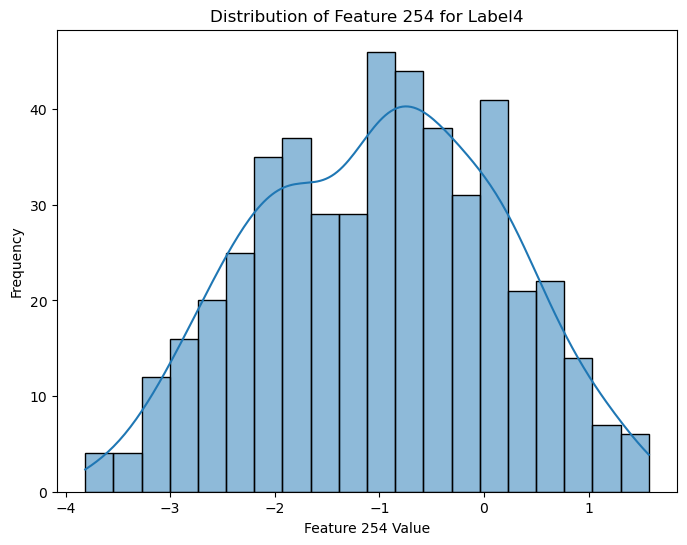

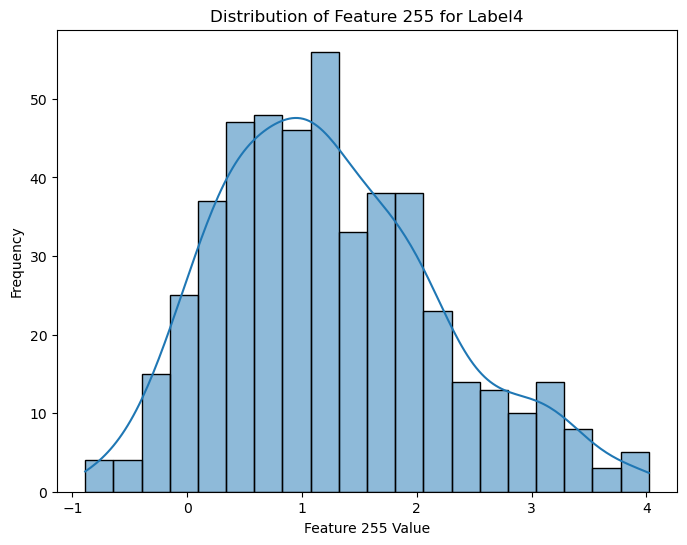

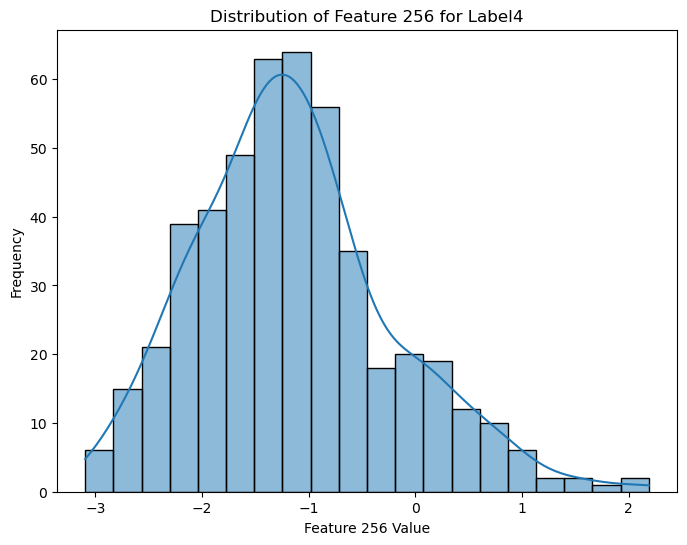

In [43]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'data' is your combined dataset with 256 features and 4 labels
labels = train_df.iloc[:, -4:].values
features = train_df.iloc[:, :-4].values

# Iterate through each label
for label_index, label_name in enumerate(['Label1', 'Label2', 'Label3', 'Label4']):
    label = labels[:, label_index]

    # Plot distribution of features for the current label
    for feature_index in range(features.shape[1]):
        feature_values = features[label == 1, feature_index]  # Select feature values for the current label
        plt.figure(figsize=(8, 6))
        sns.histplot(feature_values, bins=20, kde=True)
        plt.title(f'Distribution of Feature {feature_index+1} for {label_name}')
        plt.xlabel(f'Feature {feature_index+1} Value')
        plt.ylabel('Frequency')
        plt.show()


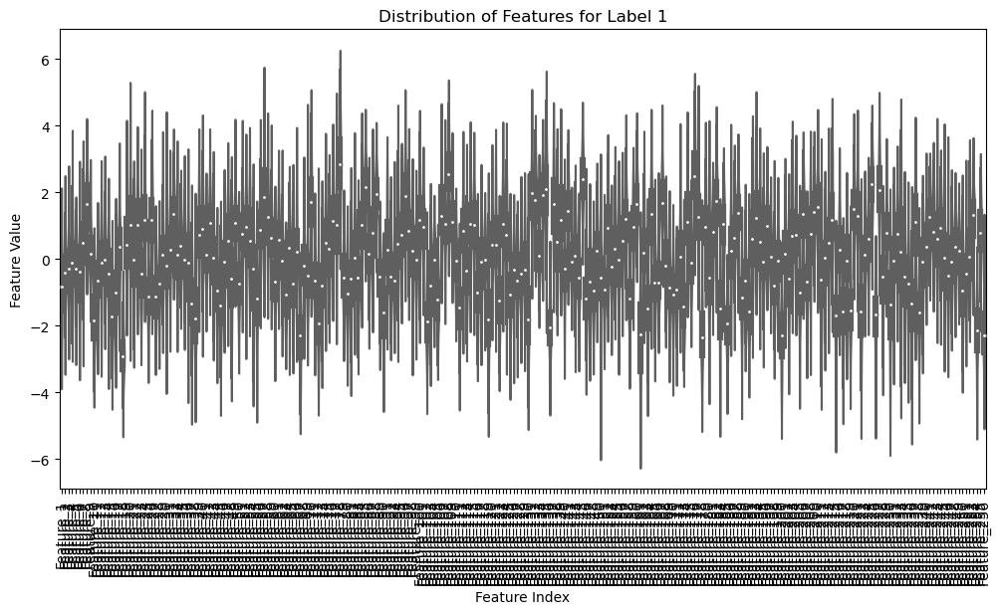

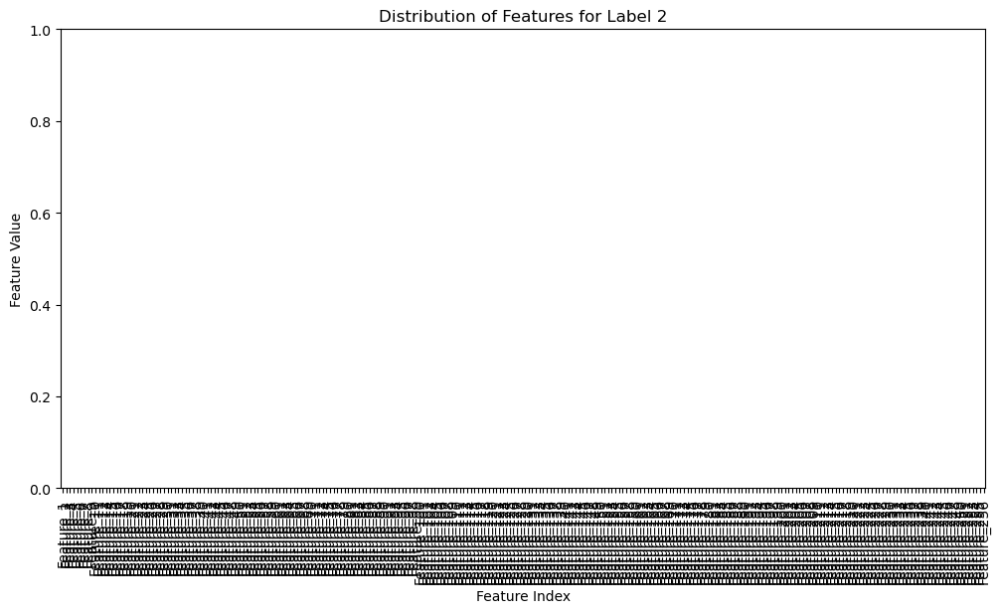

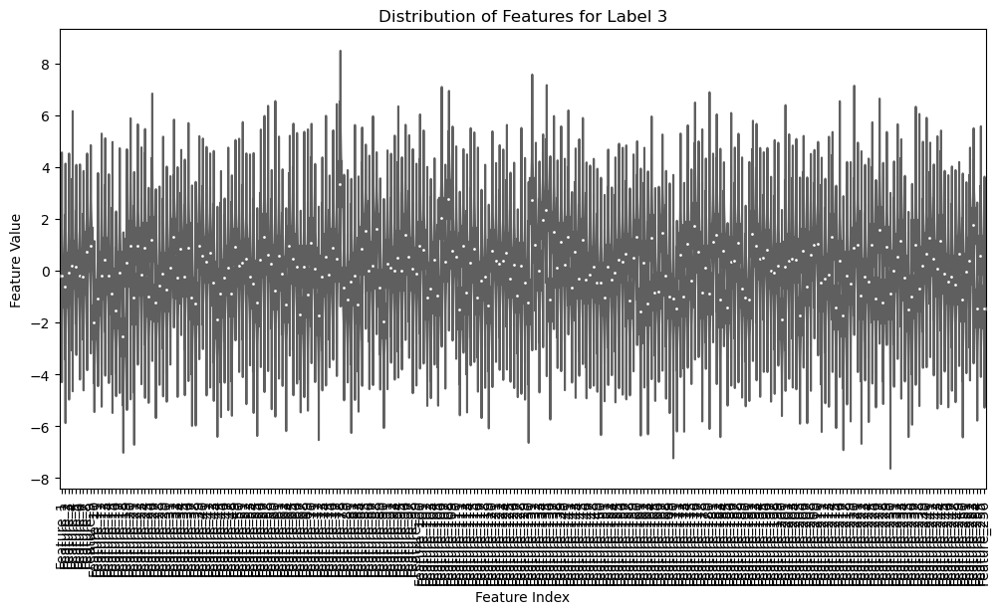

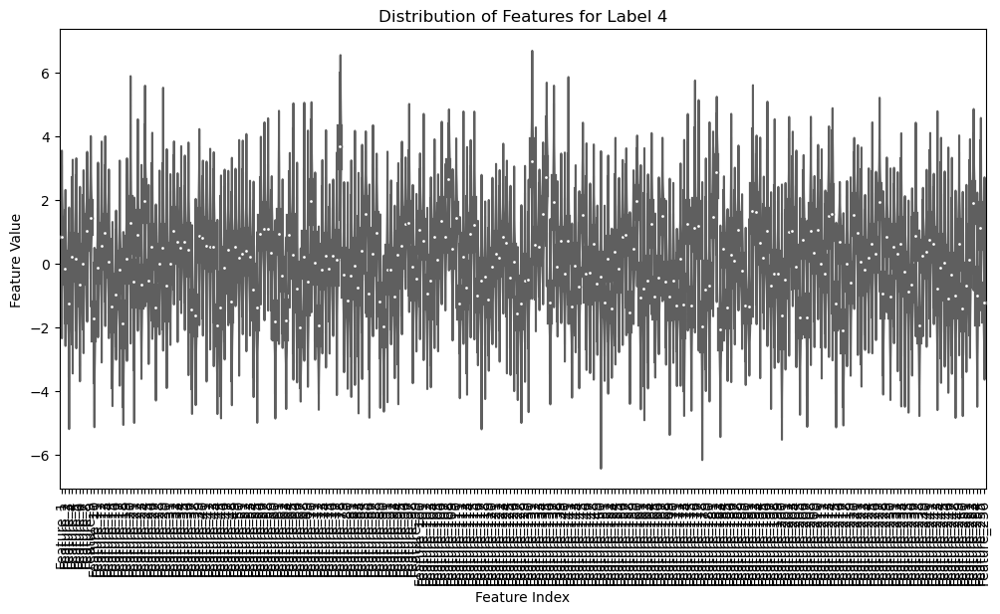

In [49]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'data' is your combined dataset with 256 features and 4 labels
labels = train_df.iloc[:, -4:].values
features = train_df.iloc[:, :-4].values


# Create a separate violin plot for each label
for label_index in range(labels.shape[1]):
    # Create a DataFrame for the specific label's feature values
    label_features_df = pd.DataFrame(data=features[labels[:, label_index] == 1, :], columns=[f'Feature_{i+1}' for i in range(features.shape[1])])
    
    # Create a violin plot
    plt.figure(figsize=(12, 6))
    sns.violinplot(data=label_features_df, palette='Set3')
    plt.title(f'Distribution of Features for Label {label_index + 1}')
    plt.xlabel('Feature Index')
    plt.ylabel('Feature Value')
    plt.xticks(rotation=90)
    plt.show()


Analyse the Tranining Data

In [8]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.cluster import KMean

# Sample data (replace with your actual data)
# Assuming 'data' is your 2D numpy array with embeddings and labels
data = train_df.values

# 1. Statistical Aggregations on Speaker Embeddings
mean_embeddings = np.mean(data[:, :256], axis=1)
std_embeddings = np.std(data[:, :256], axis=1)

# 2. Dimensionality Reduction with PCA
pca = PCA(n_components=150)
pca_embeddings = pca.fit_transform(data[:, :256])


# 3. Delta and Delta-Delta Features
delta_embeddings = np.diff(data[:, :256], axis=0)
delta_delta_embeddings = np.diff(delta_embeddings, axis=0)

# 4. Normalize and Scale Features
scaler = StandardScaler()
scaled_embeddings = scaler.fit_transform(data[:, :256])

# 5. Feature Selection with Mutual Information
labels = data[:, -4:]  # Assuming labels are in the last 4 columns
mi = mutual_info_classif(data[:, :256], labels[:, 0])
selected_features = SelectKBest(score_func=lambda X, y: mi).fit_transform(data[:, :256], labels[:, 0])

# 6. Clustering and Cluster Statistics
num_clusters = 5
kmeans = KMeans(n_clusters=num_clusters, random_state=0)
cluster_labels = kmeans.fit_predict(data[:, :256])
cluster_centers = kmeans.cluster_centers_
cluster_stats = np.std(data[cluster_labels == 0, :256], axis=0)  # Example for cluster 0

# 7. Combining Labels
combined_labels = np.concatenate((labels[:, 1:], labels[:, 0:1]), axis=1)  # Age-Gender

# Now you can use these engineered features in your machine learning pipeline


C:\Users\D.M.R.L.Dassanayake\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [7]:
print("Combined Labels:", combined_labels)

Combined Labels: [[nan  1.  6. 45.]
 [nan  1.  6. 45.]
 [nan  1.  6. 45.]
 ...
 [29.  1.  6. 39.]
 [29.  1.  6. 39.]
 [29.  1.  6. 39.]]


In [8]:
print(selected_features)

[[-0.69450474  2.23790073 -3.42679071 ... -1.92433596 -2.35050464
   0.40245038]
 [-0.52051604  0.74712491 -2.4543581  ...  0.8926335   1.99594748
  -0.01622709]
 [-0.04825938  2.934021   -2.14856815 ...  2.15281415  3.76813817
   2.3783164 ]
 ...
 [ 0.15077366  2.2438333  -2.94382048 ...  0.31174466  2.78348613
   2.04585886]
 [ 1.86733699  1.98807561 -1.34847295 ... -0.60994029 -1.14497375
  -0.22925001]
 [ 0.30425093  1.3350749  -1.64867735 ...  0.50962722  2.56359363
   1.79681337]]


In [12]:
len(selected_features)

28520

In [5]:
print("Mean Embeddings:", mean_embeddings)
print("Std Embeddings:", std_embeddings)


print("PCA Embeddings:", pca_embeddings)

print("Delta Embeddings:", delta_embeddings)
print("Delta-Delta Embeddings:", delta_delta_embeddings)


print("Scaled Embeddings:", scaled_embeddings)
print("Selected Features:", selected_features)

print("Cluster Labels:", cluster_labels)
print("Cluster Centers:", cluster_centers)
print("Cluster Stats for Cluster 0:", cluster_stats)

Mean Embeddings: [-0.01952666  0.0947765   0.24759504 ... -0.00277954 -0.062617
 -0.01206258]
Std Embeddings: [1.46845947 1.70491663 1.91596726 ... 1.53118484 1.24191672 1.45334057]
PCA Embeddings: [[ 4.28110973e-01 -5.74126849e+00 -5.53861736e+00 ...  9.79399076e-03
   3.38423533e-02  3.01547133e-02]
 [-7.17417008e+00 -6.58592151e+00  6.32820752e-01 ... -3.40850410e-02
   2.91449618e-02 -1.45881127e-02]
 [-8.42371008e+00 -8.00869777e+00  2.80968302e+00 ...  7.50822364e-03
   8.69252814e-02 -4.22201127e-02]
 ...
 [-6.49623812e+00 -3.67575409e+00 -2.84091670e+00 ... -3.60204067e-02
  -1.53914820e-03  7.67332227e-02]
 [ 3.09037535e+00 -1.80537881e-01 -7.46063337e+00 ... -2.02557016e-02
   1.67388937e-02 -5.41146584e-02]
 [-5.53974879e+00 -3.35378716e-01  2.00835881e+00 ... -5.57326068e-02
  -6.63216692e-02  8.57693058e-02]]
Delta Embeddings: [[ 0.21954834 -0.71745795 -0.14929867 ... -0.38245058  1.99650851
  -2.31084841]
 [-0.19690609  0.651436   -1.63923806 ...  1.19613045 -2.29512239
 

# Approach to predict labels

Using PCA and RandomForest Classifier for Feature Engineering to predict Speaker ID

In [67]:

# Train a RandomForestClassifier on the training data

pca = PCA(n_components=150)  # Number of components to keep
X_train_pca = pca.fit_transform(train_df.values[:, :256])  # Fit and transform training data
y_train = train_df.values[:, -4]  # Labels
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)  # Using 'Speaker ID' as the target label


# Preprocess test data (apply the same feature engineering steps as in the training phase)

X_valid_pca = pca.transform(validation_df.values[:, :256])  # Transform test data
y_valid = validation_df.values[:, -4]  # Ground truth labels

# Make predictions using the trained model
y_pred = clf.predict(X_valid_pca)

# Calculate accuracy
accuracy = accuracy_score(y_valid, y_pred)
precision = precision_score(y_valid, y_pred, average='weighted')  
recall = recall_score(y_valid, y_pred, average='weighted') 
f1 = f1_score(y_valid, y_pred, average='weighted') 

print("Accuracy of label1:", accuracy)
print("Precision of label1:", precision)
print("Recall of label1:", recall)
print("F1-Score of label1:", f1)



Accuracy of label1: 0.9653333333333334
Precision of label1: 0.9670887037512426
Recall of label1: 0.9653333333333334
F1-Score of label1: 0.9649159613193392


In [94]:
clf = RandomForestClassifier(random_state=0)

X_test = test_df.values[:, :256]

nan_indices = np.isnan(X_test)
valid_indices = ~np.any(nan_indices, axis=1)
X_test= X_test[valid_indices]

clf.fit(train_df.values[:, :256], y_train)

y_test = clf.predict(X_test)

In [108]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)
X_test_pca = pca.transform(test_df.values[:, :256])
y_test_pca = clf.predict(X_test_pca)

In [126]:
X_test_pca_df = (pd.DataFrame(X_test_pca))
y_test_df = (pd.DataFrame(y_test))
label1_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label1_after_df = pd.DataFrame(y_test_pca, columns=['Predicted labels after feature engineering'])

label1_df = pd.concat([label1_before_df, label1_after_df, X_test_pca_df], axis=1)
label1_df.to_csv('sample_label1.csv', index=False)

In [130]:
label1_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,140,141,142,143,144,145,146,147,148,149
0,45.0,45.0,-2.127144,-7.598202,-4.396460,-6.646038,3.014192,-3.112589,4.888551,1.823607,...,-0.077872,-0.002629,-0.007950,0.160427,0.116134,-0.046830,-0.210249,-0.078797,0.106016,-0.112730
1,45.0,45.0,-8.119003,-9.828140,0.191861,-7.562776,10.678703,1.089658,-2.260067,2.925670,...,0.064718,0.103433,-0.127128,0.053075,0.046732,0.159921,-0.020098,-0.267568,0.089495,-0.167959
2,45.0,45.0,-5.751535,-4.397810,-0.092524,-4.446784,4.298898,3.097758,-0.101781,-0.005172,...,0.243390,-0.039442,-0.008254,-0.138887,-0.190248,0.093857,-0.130637,-0.234928,0.107141,-0.133314
3,45.0,45.0,-2.960283,-7.226763,-0.797357,3.202733,4.425670,-1.954743,-1.318623,1.232142,...,0.566972,-0.137884,-0.114610,0.167605,-0.285048,0.160481,-0.180469,0.055137,0.208419,-0.024421
4,45.0,45.0,0.440296,-7.139061,1.913627,-4.046085,3.593655,0.181699,2.931932,3.040117,...,0.040653,0.261057,-0.231293,0.105878,0.036952,0.148357,-0.141011,0.201764,0.276179,-0.065311


Using PCA and RandomForest Classifier for Feature Engineering to predict Speaker age

In [127]:

pca = PCA(n_components=210)  # Number of components to keep
X_train_pca = pca.fit_transform(train_df.values[:, :256])  # Fit and transform training data
y_train =  train_df.values[:, -3]  # Labels

# Check for missing values in the target labels
nan_indices = np.isnan(y_train)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_train_pca = X_train_pca[~nan_indices]
    y_train = y_train[~nan_indices]
    
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)  # Using 'Speaker age' as the target label



X_valid_pca = pca.transform(validation_df.values[:, :256])  # Transform test data
y_valid = validation_df.values[:, -3]  # Ground truth labels

# Check for missing values in the target labels
nan_indices = np.isnan(y_valid)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_valid_pca = X_valid_pca[~nan_indices]
    y_valid = y_valid[~nan_indices]

# Make predictions using the trained model
y_pred = clf.predict(X_valid_pca)

# Calculate accuracy
accuracy = accuracy_score(y_valid, y_pred)
precision = precision_score(y_valid, y_pred, average='weighted')  
recall = recall_score(y_valid, y_pred, average='weighted') 
f1 = f1_score(y_valid, y_pred, average='weighted') 

print("Accuracy of label2:", accuracy)
print("Precision of label2:", precision)
print("Recall of label2:", recall)
print("F1-Score of label2:", f1)


Accuracy of label2: 0.8722826086956522
Precision of label2: 0.9002553044182512
Recall of label2: 0.8722826086956522
F1-Score of label2: 0.8757783232676957


In [133]:
clf = RandomForestClassifier(random_state=0)

X_test = test_df.values[:, :256]

nan_indices = np.isnan(X_test)
valid_indices = ~np.any(nan_indices, axis=1)
X_test= X_test[valid_indices]

clf.fit(train_df.values[:, :256], y_train)

y_test = clf.predict(X_test)

ValueError: Found input variables with inconsistent numbers of samples: [28520, 28040]

In [129]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)
X_test_pca = pca.transform(test_df.values[:, :256])
y_test_pca = clf.predict(X_test_pca)

In [131]:
X_test_pca_df = (pd.DataFrame(X_test_pca))
y_test_df = (pd.DataFrame(y_test))
label2_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label2_after_df = pd.DataFrame(y_test_pca, columns=['Predicted labels after feature engineering'])

label2_df = pd.concat([label2_before_df, label2_after_df, X_test_pca_df], axis=1)
label2_df.to_csv('sample_label2.csv', index=False)

In [132]:
label2_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,200,201,202,203,204,205,206,207,208,209
0,45.0,26.0,-2.127144,-7.598202,-4.396460,-6.646038,3.014192,-3.112589,4.888551,1.823607,...,0.019267,0.024457,-0.029142,0.118291,-0.022659,0.003961,0.037155,-0.019497,0.061727,-0.047025
1,45.0,25.0,-8.119003,-9.828140,0.191861,-7.562776,10.678703,1.089658,-2.260067,2.925670,...,0.044582,-0.099606,0.022817,0.043269,0.106020,-0.150307,0.009691,-0.074913,-0.048197,-0.030509
2,45.0,23.0,-5.751535,-4.397810,-0.092524,-4.446784,4.298898,3.097758,-0.101781,-0.005172,...,-0.029419,0.029564,-0.074953,-0.084503,0.046849,-0.227665,0.102898,-0.007428,-0.070182,-0.069617
3,45.0,26.0,-2.960283,-7.226763,-0.797357,3.202733,4.425670,-1.954743,-1.318623,1.232142,...,-0.011781,0.139979,0.058463,-0.070354,-0.023238,0.063148,-0.026997,-0.002615,0.082000,0.047900
4,45.0,31.0,0.440296,-7.139061,1.913627,-4.046085,3.593655,0.181699,2.931932,3.040117,...,0.048429,-0.082078,-0.017691,-0.067309,-0.019409,0.055403,-0.049925,0.050220,-0.151046,0.030393


Using PCA and RandomForest Classifier for Feature Engineering to predict Speaker gender

In [134]:

pca = PCA(n_components=150)  # Number of components to keep
X_train_pca = pca.fit_transform(train_df.values[:, :256])  # Fit and transform training data
y_train = train_df.values[:, -2]  # Labels
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)  # Using 'Speaker gender' as the target label

X_valid_pca = pca.transform(validation_df.values[:, :256])  # Transform test data
y_valid = validation_df.values[:, -2]  # Ground truth labels

# Make predictions using the trained model
y_pred = clf.predict(X_valid_pca)


# Calculate accuracy
accuracy = accuracy_score(y_valid, y_pred)
precision = precision_score(y_valid, y_pred, average='weighted')  
recall = recall_score(y_valid, y_pred, average='weighted') 
f1 = f1_score(y_valid, y_pred, average='weighted') 

print("Accuracy of label3:", accuracy)
print("Precision of label3:", precision)
print("Recall of label3:", recall)
print("F1-Score of label3:", f1)

Accuracy of label3: 0.9933333333333333
Precision of label3: 0.9933209889482817
Recall of label3: 0.9933333333333333
F1-Score of label3: 0.9933242937459411


In [135]:
clf = RandomForestClassifier(random_state=0)

X_test = test_df.values[:, :256]

nan_indices = np.isnan(X_test)
valid_indices = ~np.any(nan_indices, axis=1)
X_test= X_test[valid_indices]

clf.fit(train_df.values[:, :256], y_train)

y_test = clf.predict(X_test)

In [136]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)
X_test_pca = pca.transform(test_df.values[:, :256])
y_test_pca = clf.predict(X_test_pca)

In [137]:
X_test_pca_df = (pd.DataFrame(X_test_pca))
y_test_df = (pd.DataFrame(y_test))
label3_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label3_after_df = pd.DataFrame(y_test_pca, columns=['Predicted labels after feature engineering'])

label3_df = pd.concat([label3_before_df, label3_after_df, X_test_pca_df], axis=1)
label3_df.to_csv('sample_label3.csv', index=False)

In [138]:
label3_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,140,141,142,143,144,145,146,147,148,149
0,1.0,1.0,-2.127144,-7.598202,-4.396460,-6.646038,3.014192,-3.112589,4.888551,1.823607,...,-0.082931,-0.003745,-0.006518,0.159690,0.094608,-0.037201,-0.222593,-0.055812,0.126748,-0.110132
1,1.0,1.0,-8.119003,-9.828140,0.191861,-7.562776,10.678703,1.089658,-2.260067,2.925670,...,0.069791,0.108329,-0.112277,0.049823,0.056477,0.157958,0.005969,-0.265058,0.091571,-0.231021
2,1.0,1.0,-5.751535,-4.397810,-0.092524,-4.446784,4.298898,3.097758,-0.101781,-0.005172,...,0.239677,-0.030646,-0.009685,-0.139852,-0.178379,0.098057,-0.113487,-0.239116,0.106426,-0.134477
3,1.0,1.0,-2.960283,-7.226763,-0.797357,3.202733,4.425670,-1.954743,-1.318623,1.232142,...,0.573310,-0.129378,-0.116706,0.166390,-0.295479,0.160750,-0.188786,0.086349,0.237045,0.000005
4,1.0,1.0,0.440296,-7.139061,1.913627,-4.046085,3.593655,0.181699,2.931932,3.040117,...,0.047339,0.265401,-0.221625,0.107663,0.026571,0.120656,-0.136841,0.198978,0.291956,-0.104267


Using PCA and RandomForest Classifier for Feature Engineering to predict Speaker accent

In [139]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score


# Train a RandomForestClassifier on the training data
X_train = train_df.values[:, :256]  # Features
y_train = train_df.values[:, -1]   # Labels

# Check for missing values in the target labels
nan_indices = np.isnan(y_train)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_train = X_train[~nan_indices]
    y_train = y_train[~nan_indices]

# Train the model with cleaned data
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train, y_train)  # Using 'Speaker accent' as the target label


# Preprocess test data (apply the same feature engineering steps as in the training phase)
X_valid = validation_df.values[:, :256]  # Features
y_valid = validation_df.values[:, -1]   # Ground truth labels

# Check for missing values in the target labels
nan_indices = np.isnan(y_valid)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_valid = X_valid[~nan_indices]
    y_valid = y_valid[~nan_indices]

# Make predictions using the trained model
y_pred = clf.predict(X_valid)


# Calculate accuracy
accuracy = accuracy_score(y_valid, y_pred)
precision = precision_score(y_valid, y_pred, average='weighted')  
recall = recall_score(y_valid, y_pred, average='weighted') 
f1 = f1_score(y_valid, y_pred, average='weighted') 

print("Accuracy of label4:", accuracy)
print("Precision of label4:", precision)
print("Recall of label4:", recall)
print("F1-Score of label4:", f1)


Accuracy of label4: 0.848
Precision of label4: 0.8748235294117647
Recall of label4: 0.848
F1-Score of label4: 0.8225273173209297


In [140]:
clf = RandomForestClassifier(random_state=0)

X_test = test_df.values[:, :256]

nan_indices = np.isnan(X_test)
valid_indices = ~np.any(nan_indices, axis=1)
X_test= X_test[valid_indices]

clf.fit(train_df.values[:, :256], y_train)

y_test = clf.predict(X_test)

In [141]:
clf = RandomForestClassifier(random_state=0)
clf.fit(X_train_pca, y_train)
X_test_pca = pca.transform(test_df.values[:, :256])
y_test_pca = clf.predict(X_test_pca)

In [142]:
X_test_pca_df = (pd.DataFrame(X_test_pca))
y_test_df = (pd.DataFrame(y_test))
label4_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label4_after_df = pd.DataFrame(y_test_pca, columns=['Predicted labels after feature engineering'])

label4_df = pd.concat([label4_before_df, label4_after_df, X_test_pca_df], axis=1)
label4_df.to_csv('sample_label4.csv', index=False)

In [143]:
label4_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,140,141,142,143,144,145,146,147,148,149
0,6.0,6.0,-2.127144,-7.598202,-4.396460,-6.646038,3.014192,-3.112589,4.888551,1.823607,...,-0.082931,-0.003745,-0.006518,0.159690,0.094608,-0.037201,-0.222593,-0.055812,0.126748,-0.110132
1,6.0,6.0,-8.119003,-9.828140,0.191861,-7.562776,10.678703,1.089658,-2.260067,2.925670,...,0.069791,0.108329,-0.112277,0.049823,0.056477,0.157958,0.005969,-0.265058,0.091571,-0.231021
2,6.0,6.0,-5.751535,-4.397810,-0.092524,-4.446784,4.298898,3.097758,-0.101781,-0.005172,...,0.239677,-0.030646,-0.009685,-0.139852,-0.178379,0.098057,-0.113487,-0.239116,0.106426,-0.134477
3,6.0,6.0,-2.960283,-7.226763,-0.797357,3.202733,4.425670,-1.954743,-1.318623,1.232142,...,0.573310,-0.129378,-0.116706,0.166390,-0.295479,0.160750,-0.188786,0.086349,0.237045,0.000005
4,6.0,6.0,0.440296,-7.139061,1.913627,-4.046085,3.593655,0.181699,2.931932,3.040117,...,0.047339,0.265401,-0.221625,0.107663,0.026571,0.120656,-0.136841,0.198978,0.291956,-0.104267


# Different approach to predict labels 

Using SVM, Oversampling, SelectKBest for Feature Selection and Feature Engineering to predict Speaker ID

In [146]:

# Assuming 'X_train' and 'y_train' are your training features and labels
X_train = train_df.values[:, :256]  # Features
y_train = train_df.values[:, -4]  # Labels for label 1

# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_validation = validation_df.values[:, :256]  # Features
y_validation = validation_df.values[:, -4]  # Labels for label 1

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_validation_scaled = scaler.transform(X_validation)

# Apply SelectKBest feature selection
num_selected_features = 100  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_validation_selected = selector.transform(X_validation_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_pred = clf.predict(X_validation_selected)

# Calculate accuracy
accuracy = accuracy_score(y_validation, y_pred)
precision = precision_score(y_validation, y_pred, average='weighted')
recall = recall_score(y_validation, y_pred, average='weighted')
f1 = f1_score(y_validation, y_pred, average='weighted')

print("Accuracy of label1:", accuracy)
print("Precision of label1:", precision)
print("Recall of label1:", recall)
print("F1-Score of label1:", f1)


Accuracy of label1: 0.9746666666666667
Precision of label1: 0.9761685666185665
Recall of label1: 0.9746666666666667
F1-Score of label1: 0.9746789935821053


In [152]:

# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_test = test_df.values[:, :256]  # Features

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Apply SelectKBest feature selection
num_selected_features = 100  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_test_selected = selector.transform(X_test_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_test_selected = clf.predict(X_test_selected)

In [153]:
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train, y_train)
y_test = clf.predict(X_test)

In [158]:
X_test_selected_df = (pd.DataFrame(X_test_selected))
y_test_df = (pd.DataFrame(y_test))
label1_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label1_after_df = pd.DataFrame(y_test_selected, columns=['Predicted labels after feature engineering'])

label1_df = pd.concat([label1_before_df, label1_after_df, X_test_selected_df], axis=1)
label1_df.to_csv('sample_label1_1.csv', index=False)

In [159]:
label1_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,90,91,92,93,94,95,96,97,98,99
0,45.0,45.0,0.243750,0.882556,1.445499,-1.402804,-0.276310,0.952007,-0.517375,-0.531767,...,1.756189,-0.307247,0.855491,-0.556945,-0.760414,0.636941,1.121620,0.150938,-0.636157,0.648066
1,45.0,45.0,0.408774,0.705594,2.577148,-0.630998,0.391542,1.137876,0.360555,-2.499126,...,1.613670,-0.106989,1.327277,-0.866287,-0.643353,1.243210,0.376992,0.975521,0.184287,0.050864
2,45.0,45.0,0.141163,0.289171,1.569386,-0.344574,-0.056533,0.196269,0.770537,-0.816171,...,0.767375,-0.107680,1.548845,-0.317583,0.383294,0.421595,-0.026535,0.228908,-0.504714,-0.320741
3,45.0,45.0,0.367645,-0.065049,1.223494,-0.759616,-0.652726,1.873993,0.526836,0.591939,...,0.684389,0.383664,-0.068565,0.405280,-0.186898,1.211388,0.269379,-0.042449,-0.503083,0.164180
4,45.0,45.0,0.326067,1.046432,0.984447,-0.194865,-0.549606,0.513264,0.765474,-0.781644,...,1.474108,0.105626,-0.335761,-0.394057,-0.933060,0.748612,1.509580,0.137893,-0.368422,-0.052867


Using SVM, Oversampling, SelectKBest for Feature Selection and Feature Engineering to predict Speaker age

In [160]:
    
# Assuming 'X_train' and 'y_train' are your training features and labels
X_train = train_df.values[:, :256]  # Features
y_train = train_df.values[:, -3]  # Labels for label 2

# Check for missing values in the target labels
nan_indices = np.isnan(y_train)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_train = X_train[~nan_indices]
    y_train = y_train[~nan_indices]
    

# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_validation = validation_df.values[:, :256]  # Features
y_validation = validation_df.values[:, -3]  # Labels for label 2

# Check for missing values in the target labels
nan_indices = np.isnan(y_validation)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_validation = X_validation[~nan_indices]
    y_validation = y_validation[~nan_indices]
    


# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_validation_scaled = scaler.transform(X_validation)

# Apply SelectKBest feature selection
num_selected_features = 150  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_validation_selected = selector.transform(X_validation_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_pred = clf.predict(X_validation_selected)

# Calculate accuracy
accuracy = accuracy_score(y_validation, y_pred)
precision = precision_score(y_validation, y_pred, average='weighted')
recall = recall_score(y_validation, y_pred, average='weighted')
f1 = f1_score(y_validation, y_pred, average='weighted')

print("Accuracy of label2:", accuracy)
print("Precision of label2:", precision)
print("Recall of label2:", recall)
print("F1-Score of label2:", f1)

Accuracy of label2: 0.8682065217391305
Precision of label2: 0.8722540261525806
Recall of label2: 0.8682065217391305
F1-Score of label2: 0.8683351299481817


In [161]:
# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_test = test_df.values[:, :256]  # Features

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Apply SelectKBest feature selection
num_selected_features = 150  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_test_selected = selector.transform(X_test_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_test_selected = clf.predict(X_test_selected)

In [162]:
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train, y_train)
y_test = clf.predict(X_test)

In [163]:
X_test_selected_df = (pd.DataFrame(X_test_selected))
y_test_df = (pd.DataFrame(y_test))
label2_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label2_after_df = pd.DataFrame(y_test_selected, columns=['Predicted labels after feature engineering'])

label2_df = pd.concat([label2_before_df, label2_after_df, X_test_selected_df], axis=1)
label2_df.to_csv('sample_label2_2.csv', index=False)

In [164]:
label2_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,140,141,142,143,144,145,146,147,148,149
0,27.0,27.0,0.222143,1.553302,0.247788,-0.628089,-1.459635,-0.238492,-0.207950,0.937521,...,0.676792,-0.507964,-1.012142,1.105790,0.207706,-0.867047,0.588008,-0.556738,-0.112130,0.726528
1,30.0,30.0,0.393068,2.697984,-1.249753,1.398939,-0.647807,0.433491,0.209703,0.967827,...,1.296007,0.375285,-1.188474,0.373160,1.018720,-0.891048,-0.248716,0.238442,0.283571,0.089161
2,28.0,27.0,0.115888,1.678616,-1.489115,1.163400,-0.346531,-0.017356,-0.689896,0.969687,...,0.456848,0.131667,0.045695,-0.023865,0.284393,-0.189877,-0.260292,-0.429343,-0.561448,-0.307436
3,30.0,25.0,0.350468,1.328740,0.091141,-0.218164,-0.783095,-0.617235,-0.772149,0.067588,...,1.263505,0.096051,0.475076,0.267280,0.017501,0.692410,0.253187,-0.427762,-0.706103,0.210098
4,27.0,27.0,0.307404,1.086941,-1.619376,0.280418,-0.189059,-0.513477,0.703781,-0.123338,...,0.790848,-0.568656,1.000597,1.487499,0.194876,0.498106,-0.281251,-0.297248,-0.647698,-0.021547


Improvement of Using SVM, Oversampling, RandomForestClassifier for Feature Selection and Feature Engineering to predict Speaker age with adjusting num_selected_features = 160 and n_estimator = 150 of RandomForestClassifier

In [166]:

# Assuming 'train_df' is your training DataFrame and 'validation_df' is your validation DataFrame
X_train = train_df.values[:, :256]  # Features
y_train = train_df.values[:, -3]  # Labels for label 2

# Check for missing values in the target labels
nan_indices = np.isnan(y_train)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_train = X_train[~nan_indices]
    y_train = y_train[~nan_indices]

X_validation = validation_df.values[:, :256]  # Features
y_validation = validation_df.values[:, -3]  # Labels for label 2

# Check for missing values in the target labels
nan_indices = np.isnan(y_validation)
if np.any(nan_indices):
    print("Warning: Missing values found in target labels. Removing samples with missing values.")
    X_validation = X_validation[~nan_indices]
    y_validation = y_validation[~nan_indices]

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_validation_scaled = scaler.transform(X_validation)

# Apply SelectKBest feature selection
num_selected_features = 160  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_validation_selected = selector.transform(X_validation_scaled)

# Train a RandomForestClassifier on the selected features
clf = RandomForestClassifier(n_estimators=150, random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_pred = clf.predict(X_validation_selected)

# Calculate metrics
accuracy = accuracy_score(y_validation, y_pred)
precision = precision_score(y_validation, y_pred, average='weighted')
recall = recall_score(y_validation, y_pred, average='weighted')
f1 = f1_score(y_validation, y_pred, average='weighted')

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-Score:", f1)


Accuracy: 0.9347826086956522
Precision: 0.9439736374544936
Recall: 0.9347826086956522
F1-Score: 0.9361553002258206


In [167]:
# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_test = test_df.values[:, :256]  # Features

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Apply SelectKBest feature selection
num_selected_features = 160  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_test_selected = selector.transform(X_test_scaled)


# Train a RandomForestClassifier on the selected features
clf = RandomForestClassifier(n_estimators=150, random_state=0)
clf.fit(X_train_selected, y_train_resampled)



# Make predictions on the validation data using the trained model
y_test_selected = clf.predict(X_test_selected)

In [168]:
clf = RandomForestClassifier(n_estimators=150, random_state=0)
clf.fit(X_train_selected, y_train_resampled)
y_test_selected = clf.predict(X_test_selected)


In [169]:
clf = RandomForestClassifier(n_estimators=150, random_state=0)
clf.fit(X_train, y_train)
y_test = clf.predict(X_test)


In [170]:
X_test_selected_df = (pd.DataFrame(X_test_selected))
y_test_df = (pd.DataFrame(y_test))
label2_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label2_after_df = pd.DataFrame(y_test_selected, columns=['Predicted labels after feature engineering'])

label2_df = pd.concat([label2_before_df, label2_after_df, X_test_selected_df], axis=1)
label2_df.to_csv('sample_label2_2_improved.csv', index=False)

In [171]:
label2_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,150,151,152,153,154,155,156,157,158,159
0,26.0,26.0,0.224411,1.550490,0.245924,-0.624582,-1.458301,-0.234350,-0.209681,0.839763,...,0.678473,-0.512777,-1.011843,1.107801,0.207691,-0.864755,0.591277,-0.560225,-0.110972,0.731321
1,28.0,28.0,0.395188,2.692694,-1.256707,1.391829,-0.647420,0.436731,0.207846,0.819536,...,1.301528,0.372388,-1.187745,0.373384,1.017809,-0.888683,-0.245100,0.234704,0.283799,0.091174
2,27.0,27.0,0.118248,1.675533,-1.496883,1.157523,-0.346496,-0.013510,-0.691482,0.315391,...,0.457165,0.128241,0.043414,-0.024611,0.284293,-0.189672,-0.256671,-0.432871,-0.559233,-0.307152
3,27.0,26.0,0.352625,1.326414,0.088745,-0.216805,-0.782550,-0.612585,-0.773710,0.994400,...,1.268824,0.092549,0.471748,0.267246,0.017696,0.689897,0.256594,-0.431290,-0.703549,0.212639
4,31.0,27.0,0.309598,1.085138,-1.627587,0.279166,-0.189207,-0.508966,0.701775,0.335736,...,0.793236,-0.573601,0.995988,1.490442,0.194875,0.496192,-0.277622,-0.300817,-0.645280,-0.020016


Using SVM, Oversampling, SelectKBest for Feature Selection and Feature Engineering to predict Speaker gender 

In [172]:

# Assuming 'X_train' and 'y_train' are your training features and labels
X_train = train_df.values[:, :256]  # Features
y_train = train_df.values[:, -2]  # Labels for label 3

# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_validation = validation_df.values[:, :256]  # Features
y_validation = validation_df.values[:, -2]  # Labels for label 3

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_validation_scaled = scaler.transform(X_validation)

# Apply SelectKBest feature selection
num_selected_features = 100  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_validation_selected = selector.transform(X_validation_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_pred = clf.predict(X_validation_selected)

# Calculate accuracy
accuracy = accuracy_score(y_validation, y_pred)
precision = precision_score(y_validation, y_pred, average='weighted')
recall = recall_score(y_validation, y_pred, average='weighted')
f1 = f1_score(y_validation, y_pred, average='weighted')

print("Accuracy of label3:", accuracy)
print("Precision of label3:", precision)
print("Recall of label3:", recall)
print("F1-Score of label3:", f1)

Accuracy of label3: 0.9986666666666667
Precision of label3: 0.9986759906759908
Recall of label3: 0.9986666666666667
F1-Score of label3: 0.9986684571511081


In [173]:
# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_test = test_df.values[:, :256]  # Features

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Apply SelectKBest feature selection
num_selected_features = 150  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_test_selected = selector.transform(X_test_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_test_selected = clf.predict(X_test_selected)

In [174]:
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train, y_train)
y_test = clf.predict(X_test)

In [175]:
X_test_selected_df = (pd.DataFrame(X_test_selected))
y_test_df = (pd.DataFrame(y_test))
label3_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label3_after_df = pd.DataFrame(y_test_selected, columns=['Predicted labels after feature engineering'])

label3_df = pd.concat([label3_before_df, label3_after_df, X_test_selected_df], axis=1)
label3_df.to_csv('sample_label3_3.csv', index=False)

In [176]:
label3_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,140,141,142,143,144,145,146,147,148,149
0,1.0,1.0,1.039378,1.482978,-0.397349,-0.388242,1.105474,1.092883,-0.720889,-0.187436,...,1.024762,0.780479,-0.409917,-1.648614,-0.256666,1.295948,0.686748,-0.329780,-0.104488,0.819142
1,1.0,1.0,0.863214,2.715451,1.492347,0.271206,1.134550,1.294848,0.136914,-1.533143,...,1.470900,1.400136,0.512769,-0.365758,-0.370199,0.578547,-0.131332,0.044197,0.302782,0.247988
2,1.0,1.0,0.448667,1.617903,1.272765,-0.171231,1.136335,0.271698,0.537497,-0.467766,...,1.680422,0.560378,0.258273,-1.396725,-0.075753,0.189774,-0.142650,0.184682,-0.566942,-0.107408
3,1.0,1.0,0.096044,1.241193,-0.015197,-0.759921,0.270844,2.094712,0.299383,-2.048465,...,0.150942,1.367611,0.221068,-0.486179,0.191694,0.474868,0.359387,-0.709132,-0.715826,0.356362
4,1.0,1.0,1.202516,0.980849,0.449606,-0.658099,0.087667,0.616144,0.532550,-0.444069,...,-0.101727,0.894616,-0.473319,-1.627549,0.315856,1.669722,-0.163142,0.631922,-0.655713,0.148782


Using SVM, Oversampling, SelectKBest for Feature Selection and Feature Engineering to predict Speaker accent

In [177]:

# Assuming 'X_train' and 'y_train' are your training features and labels
X_train = train_df.values[:, :256]  # Features
y_train = train_df.values[:, -1]  # Labels for label 4

# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_validation = validation_df.values[:, :256]  # Features
y_validation = validation_df.values[:, -1]  # Labels for label 4

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_validation_scaled = scaler.transform(X_validation)

# Apply SelectKBest feature selection
num_selected_features = 170  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_validation_selected = selector.transform(X_validation_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_pred = clf.predict(X_validation_selected)

# Calculate accuracy
accuracy = accuracy_score(y_validation, y_pred)
precision = precision_score(y_validation, y_pred, average='weighted')
recall = recall_score(y_validation, y_pred, average='weighted')
f1 = f1_score(y_validation, y_pred, average='weighted')

print("Accuracy of label4:", accuracy)
print("Precision of label4:", precision)
print("Recall of label4:", recall)
print("F1-Score of label4:", f1)

Accuracy of label4: 0.9546666666666667
Precision of label4: 0.9552379424528863
Recall of label4: 0.9546666666666667
F1-Score of label4: 0.9541674469325855


In [178]:
# Assuming 'X_validation' and 'y_validation' are your validation features and labels
X_test = test_df.values[:, :256]  # Features

# Apply oversampling to handle class imbalance
oversampler = RandomOverSampler(sampling_strategy='minority')
X_train_resampled, y_train_resampled = oversampler.fit_resample(X_train, y_train)

# Standardize features
scaler = RobustScaler()
X_train_scaled = scaler.fit_transform(X_train_resampled)
X_test_scaled = scaler.transform(X_test)

# Apply SelectKBest feature selection
num_selected_features = 150  # Adjust the number of selected features as needed
selector = SelectKBest(score_func=f_classif, k=num_selected_features)
X_train_selected = selector.fit_transform(X_train_scaled, y_train_resampled)
X_test_selected = selector.transform(X_test_scaled)

# Train an SVM classifier on the selected features
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train_selected, y_train_resampled)

# Make predictions on the validation data using the trained model
y_test_selected = clf.predict(X_test_selected)

In [179]:
clf = SVC(kernel='linear', random_state=0)
clf.fit(X_train, y_train)
y_test = clf.predict(X_test)

In [180]:
X_test_selected_df = (pd.DataFrame(X_test_selected))
y_test_df = (pd.DataFrame(y_test))
label4_before_df = pd.DataFrame(y_test, columns=['Predicted labels before feature engineering'])
label4_after_df = pd.DataFrame(y_test_selected, columns=['Predicted labels after feature engineering'])

label4_df = pd.concat([label4_before_df, label4_after_df, X_test_selected_df], axis=1)
label4_df.to_csv('sample_label4_4.csv', index=False)

In [181]:
label4_df.head()

,Predicted labels before feature engineering,Predicted labels after feature engineering,0,1,2,3,4,5,6,7,...,140,141,142,143,144,145,146,147,148,149
0,6.0,6.0,-0.115792,1.160052,1.659087,-1.666417,1.457433,-0.479460,1.177840,0.675531,...,-1.015729,0.791682,-0.686585,-1.122557,-1.572633,1.233069,0.310806,0.583538,-1.261626,0.936098
1,6.0,6.0,0.032217,0.973847,2.884933,-0.901861,0.533521,-1.139267,1.158259,0.703450,...,-0.898649,1.410164,0.203299,-1.288178,-0.151056,0.433546,1.211956,-0.317498,0.166479,0.272868
2,6.0,6.0,-0.207801,0.535674,1.793286,-0.618128,0.458127,-0.796508,0.670205,0.705164,...,0.128162,0.571998,-0.042150,-0.128976,-1.293505,0.000270,0.396015,-0.329963,-0.500520,-0.139822
3,6.0,6.0,-0.004671,0.162954,1.418602,-1.029271,1.421753,0.435436,1.327542,-0.125894,...,-0.442121,1.377701,-0.078032,0.274323,-0.284499,0.317999,0.099461,0.222982,-0.863195,0.398712
4,6.0,6.0,-0.041962,1.332487,1.159658,-0.469826,0.860396,-0.054361,0.689900,-0.301783,...,-1.188402,0.905603,-0.747733,0.767923,-1.549290,1.649630,0.296550,-0.352533,0.407291,0.157668
